# Image Analysis in python


## Setup

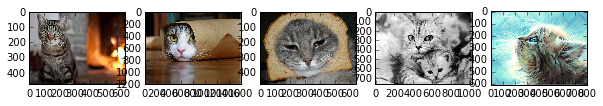

In [40]:
# Bring in necessary libraries
## Adds all the needed python libraries
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
from skimage import color
import skimage.filters as filters
import skimage.exposure as exposure
import skimage.feature as feature
from skimage.transform import hough_circle
from skimage.feature import peak_local_max
from skimage import morphology
from skimage.draw import circle_perimeter
from skimage import img_as_float, img_as_ubyte, img_as_uint
from skimage import segmentation as seg
from skimage.morphology import watershed
from skimage.morphology import disk
from scipy import ndimage as nd
from scipy.ndimage import convolve
import glob # for bulk file import

# Set defaults
## Sets the default settings for the images. We set the default size,
## and grayscale images are in grayscale.
plt.rcParams['image.cmap'] = 'gray' # Display grayscale images in... grayscale.
plt.rcParams['image.interpolation'] = 'none' # Use nearest-neighbour
plt.rcParams['figure.figsize'] = 10, 10

# Import test images
## Import all of the images that are jpgs and pngs. Save them as
## 8-bit unsigned integer format.
imgpaths = glob.glob("./images/*.jpg") + glob.glob("./images/*.png")
imgset = [img_as_ubyte(mpimg.imread(x)) for x in imgpaths]

# Display thumbnails of the images to ensure loading
## Loads the images as thumbnails. No other changes have been made,
## uses the default settings. Grayscales are still grayscale.
plt.figure()
for i,img in enumerate(imgset):
    plt.subplot(1, len(imgset), i+1)
    plt.imshow(img, cmap = 'gray')

## Color and Exposure

### Histograms and color channels

In [41]:
# Plots a histogram of the image, splitting into individual channels if necessary.
## Plots a histogram of the basic colors used in the image. It splits it up into
## r, g, b.
def plot_multichannel_histo(img):
    if img.ndim == 2: # plot grayscale histo
        plt.hist(img.flatten(), 256,  range=(0,255), color='k', histtype='step')
    elif img.ndim == 3: # print rgb histo
        plt.hist(img.reshape(-1,3), 256,  range=(0,255), color=['r','g','b'],histtype='step')
    else: # Not an image
        print("Must pass a valid RGB or grayscale image")
    plt.xlim([0,255])

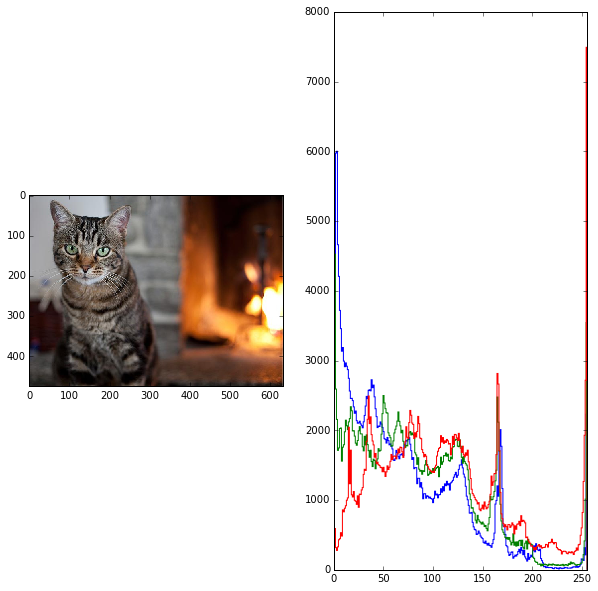

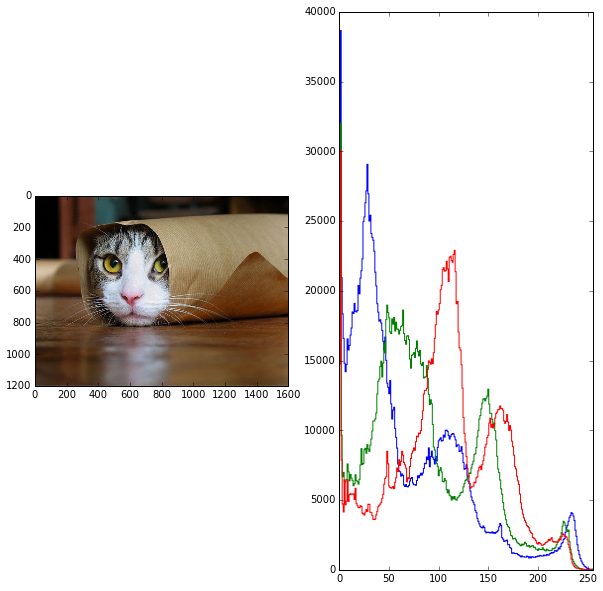

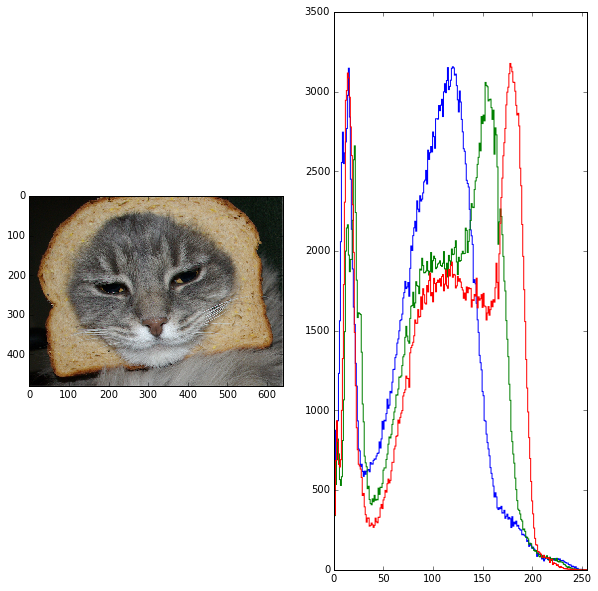

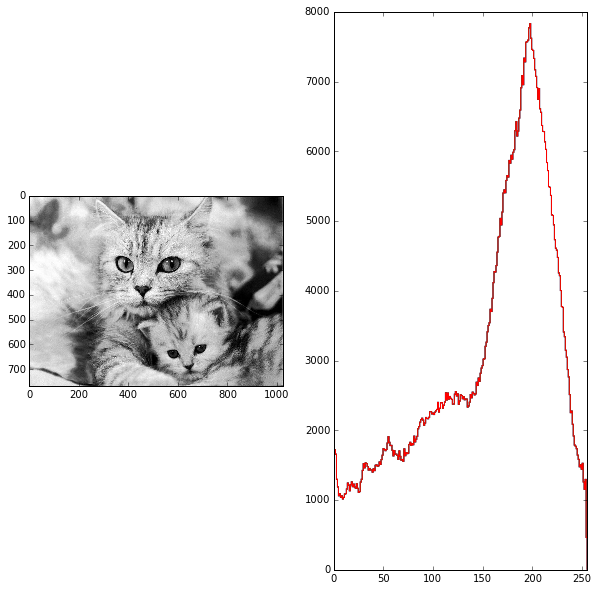

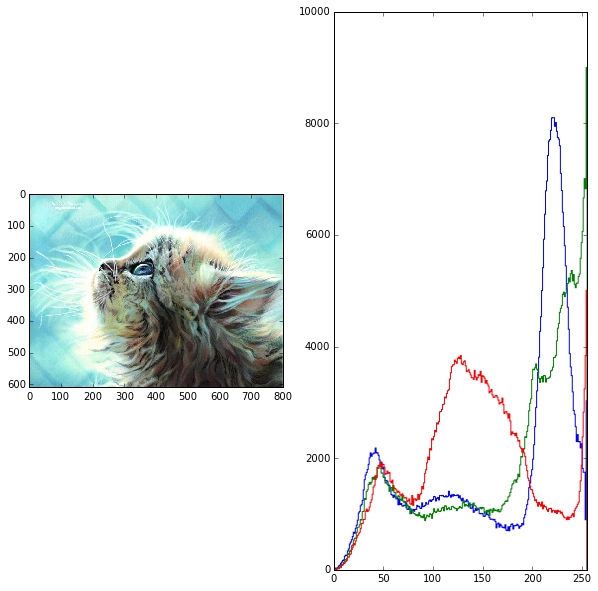

In [42]:
# Apply to image set
## Display the image and then the histogram of its basic colors
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.subplot(1, 2, 2)
    plot_multichannel_histo(img)

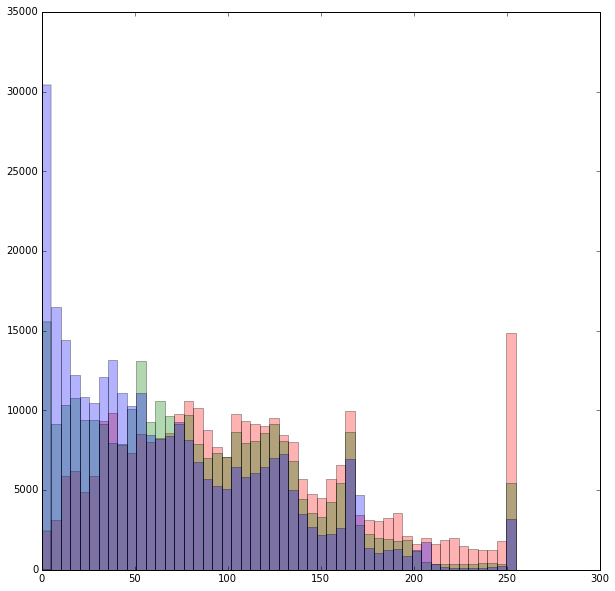

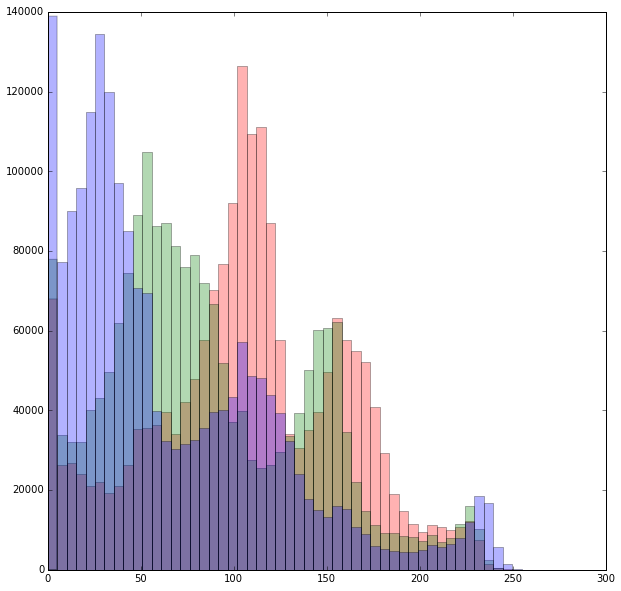

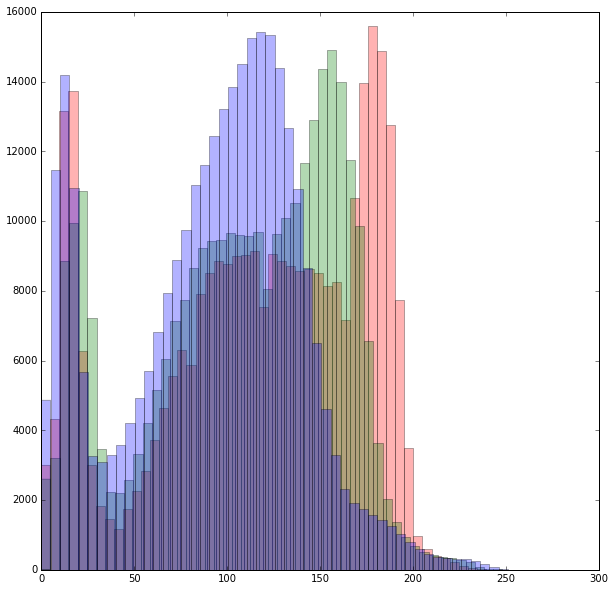

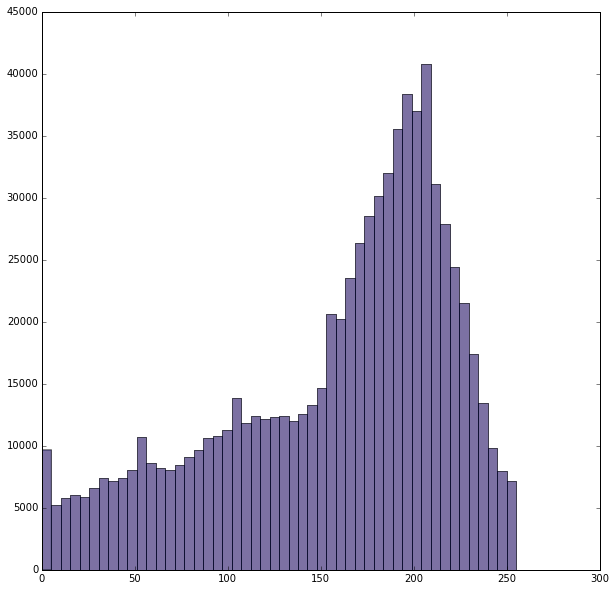

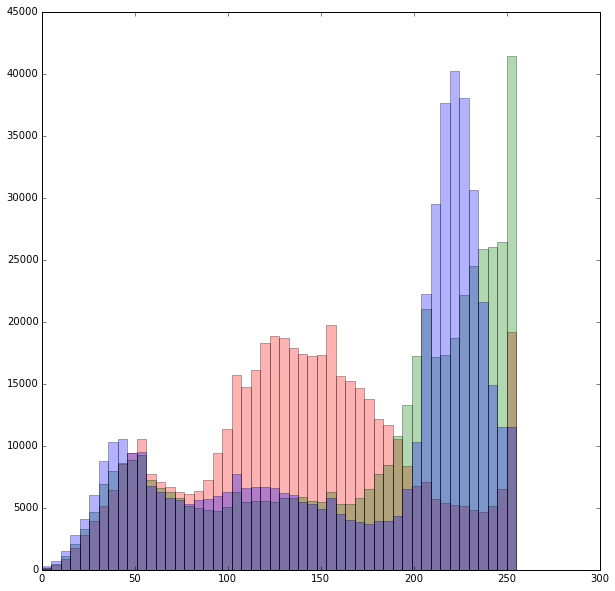

In [43]:
# Alternate histogram syntax
## Display the histograms of basic colors in bar histogram form

for x in range(len(imgset)):
    plt.figure()
    for col, channel in zip('rgb',np.rollaxis(imgset[x],axis=-1)):
        plt.hist(channel.flatten(), bins=50, color=col,alpha=0.3)

### Thresholding Images 

In [44]:
# Plot a per-channel thresholded image and its corresponding histogram
## There's a threshold for each channel (r, g, b). Only the part of
## the channel below that threshold gets shown in the picture.
def plot_threshold_with_histo(img, thresh):
    plt.subplot(1, 2, 1)
    plt.imshow(img > thresh)
    plt.subplot(1, 2, 2)
    plot_multichannel_histo(img)
    plt.axvline(thresh, color='red');

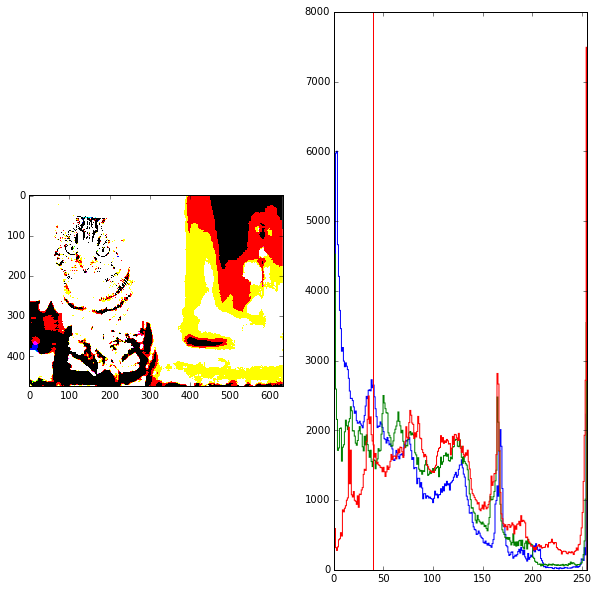

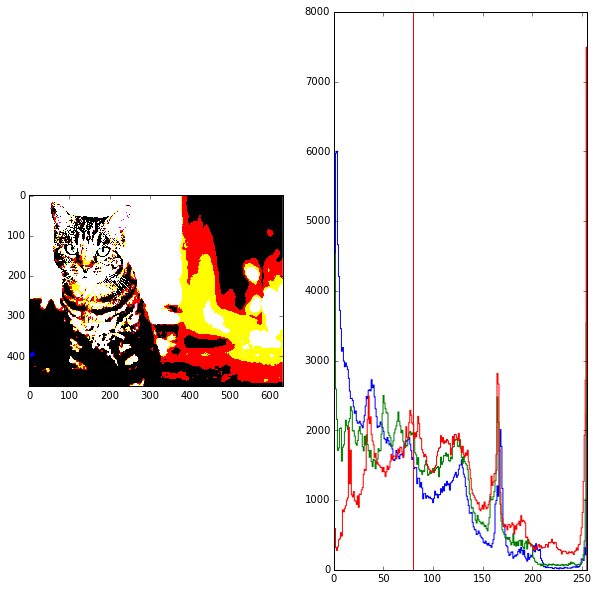

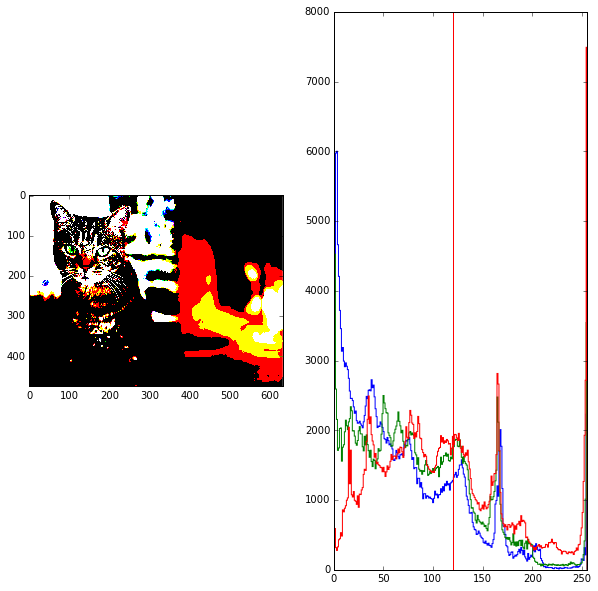

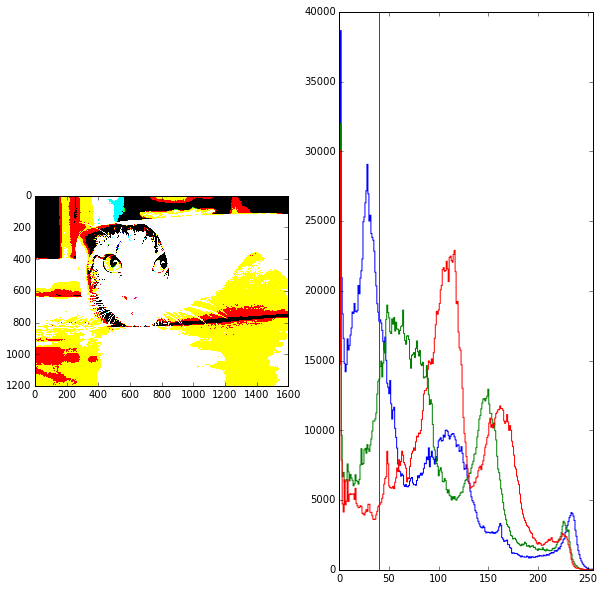

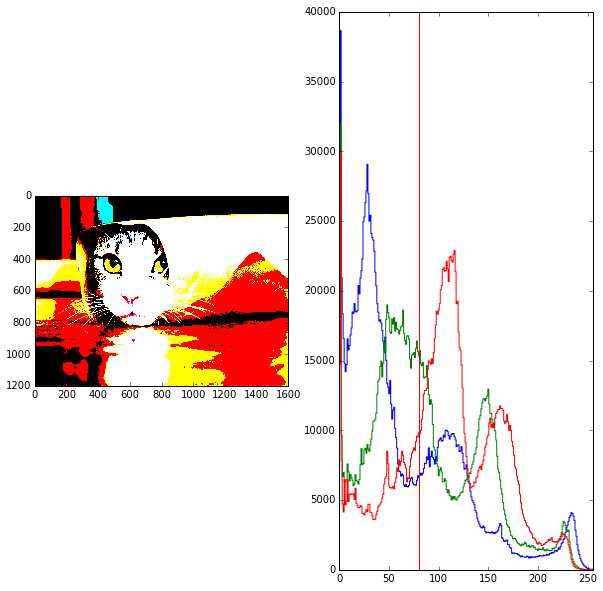

...

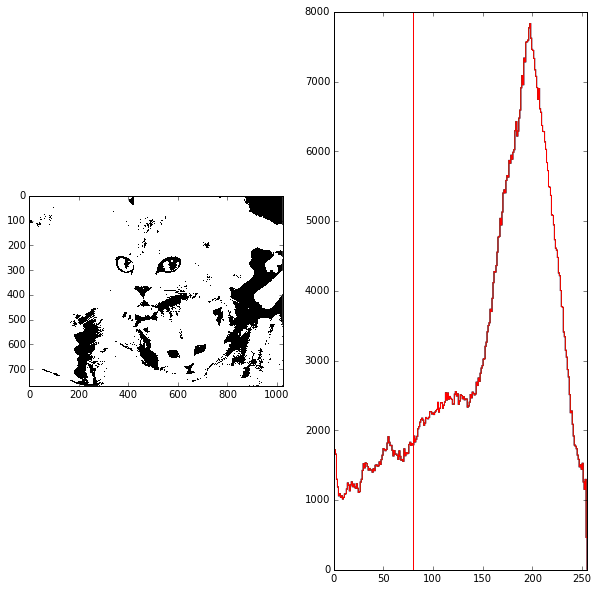

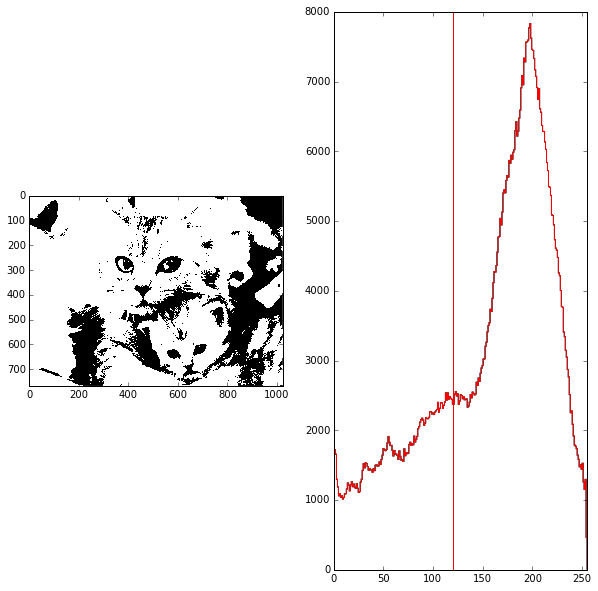

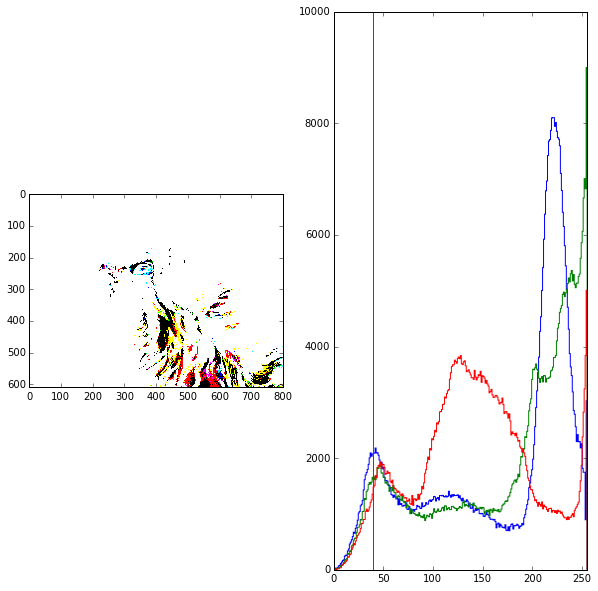

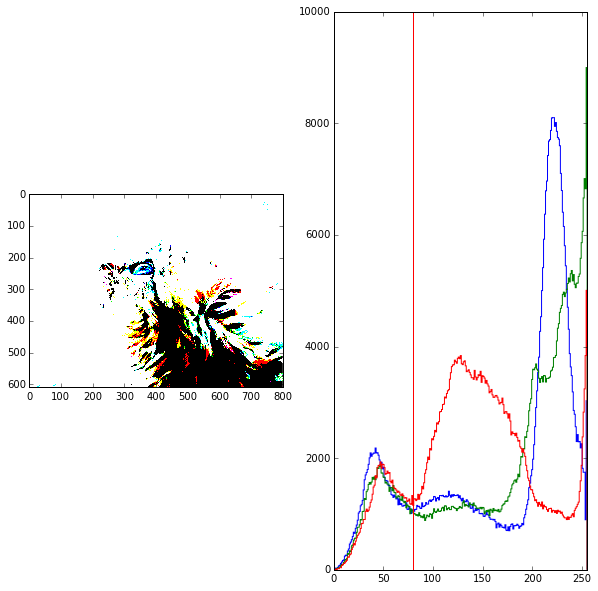

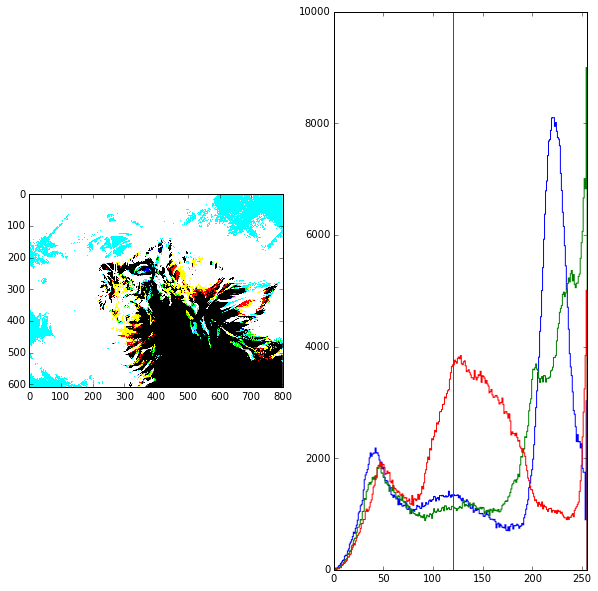

In [45]:
# Apply to image set
## Apply to the imageset with multiple thresholds.
for i,img in enumerate(imgset):
    for x in range(40, 121, 40):
        plt.figure()
        plot_threshold_with_histo(img, x)

### Sepia and color filters

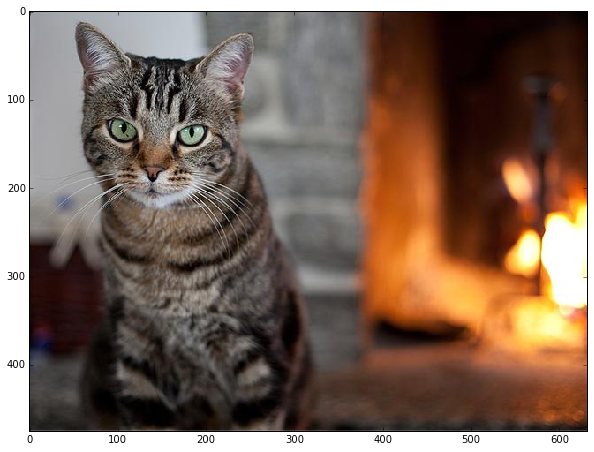

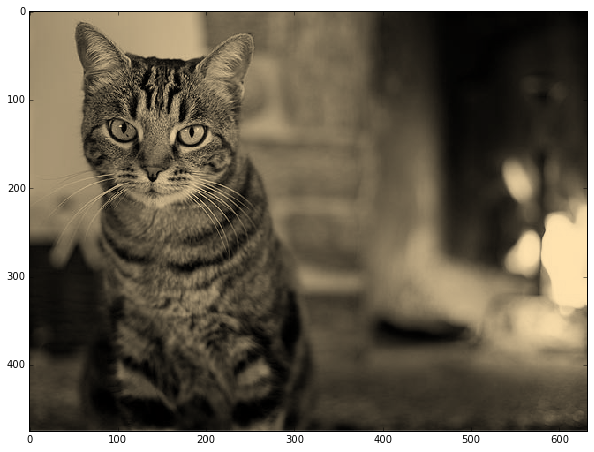

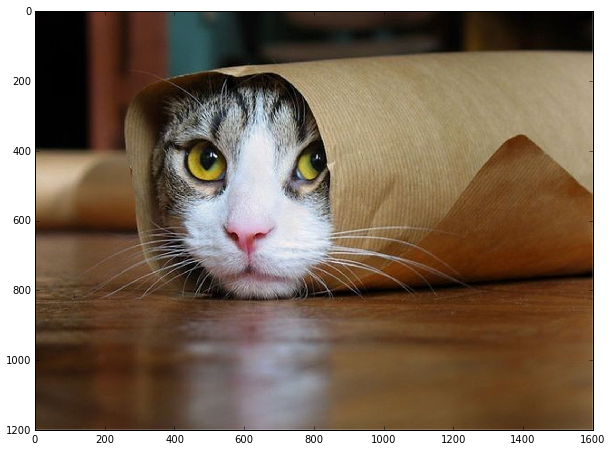

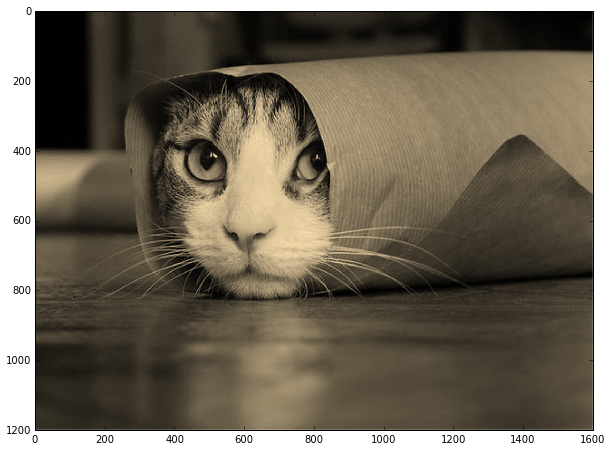

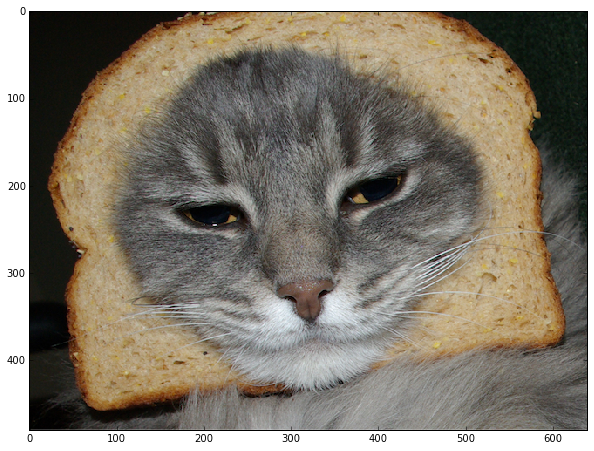

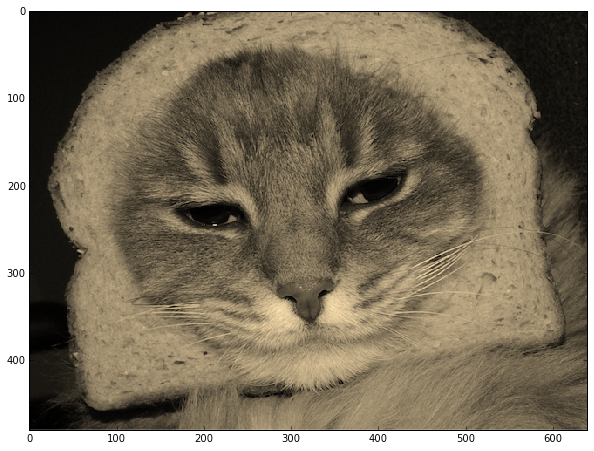

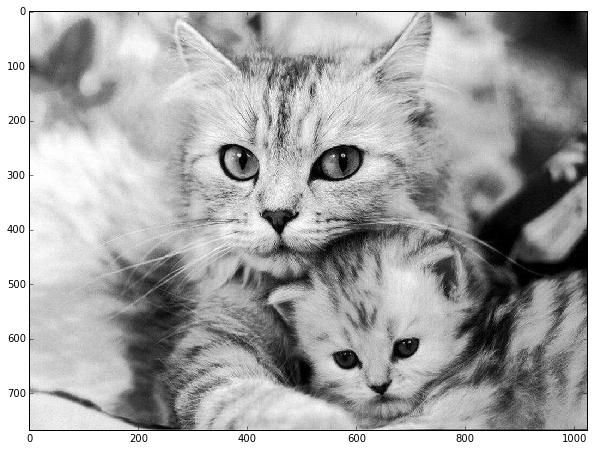

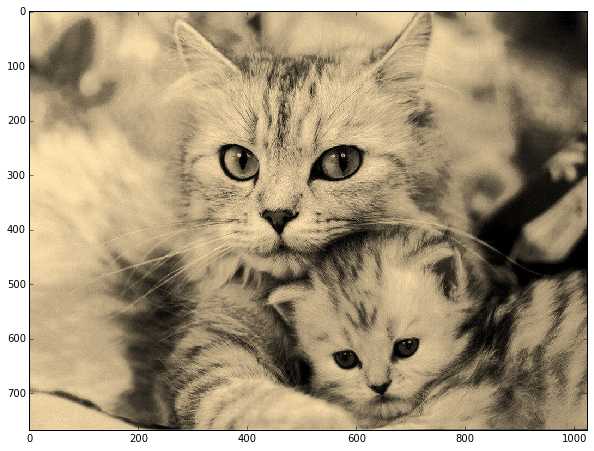

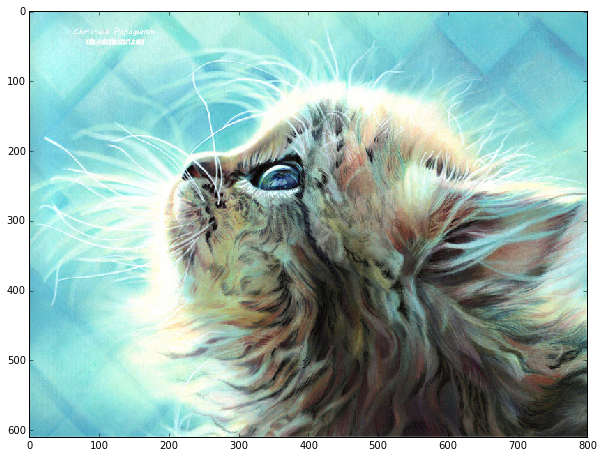

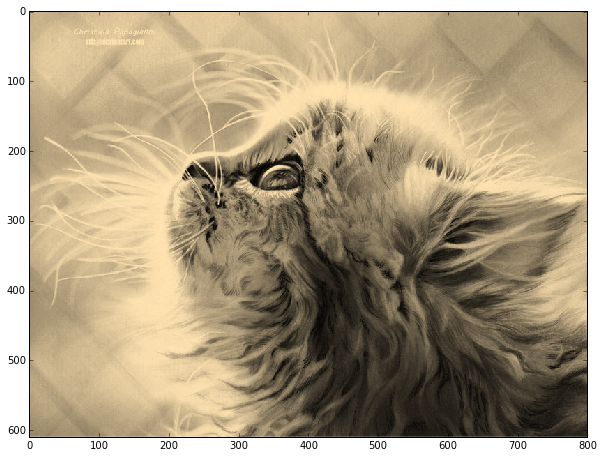

In [46]:
# Sepia and color filters
## The technique tints an image with a sepia filter. This can liven up
## an image.
def sepia_filter(img):
  #create a kernel which will be used to the original image.
  sepia_filter = np.array([[.393, .769, .189],
                           [.349, .686, .168],
                           [.272, .534, .131]])
  #Dot product the image and array
  #T is the transpose of the array.
  sepia_img = img.dot(sepia_filter.T)

  #Since our filter lines do not have unit sum, so we need to rescale
  sepia_img /= sepia_img.max()
  return sepia_img

for i,img in enumerate(imgset):
    sepia = sepia_filter(img)
    plt.imshow(img)
    plt.show()
    plt.imshow(sepia)
    plt.show()    


### Enhance Contrast

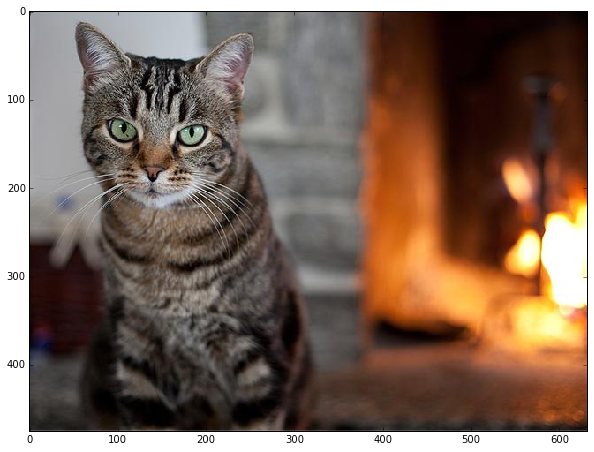

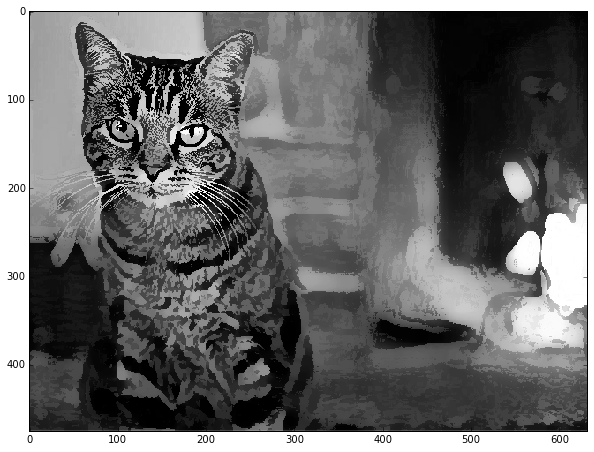

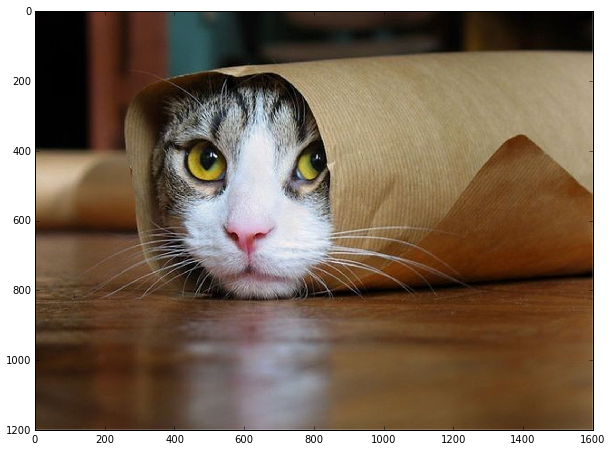

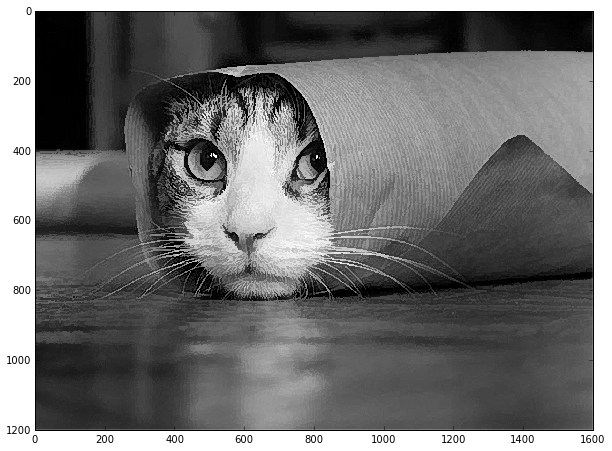

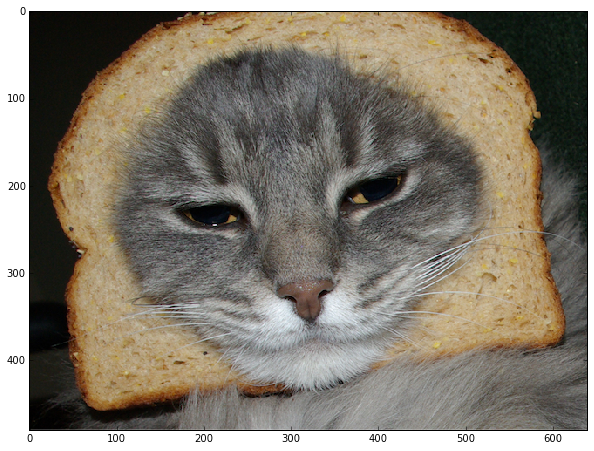

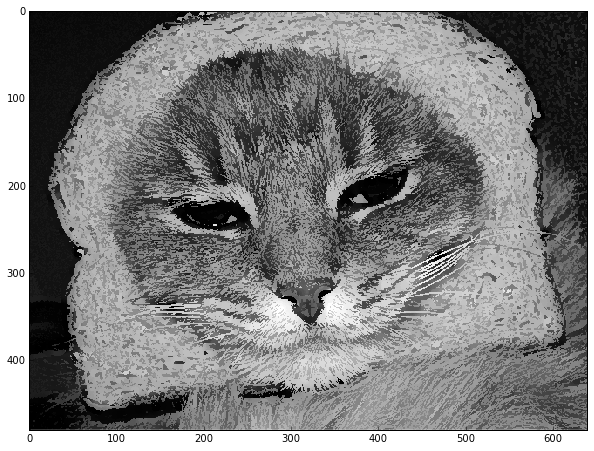

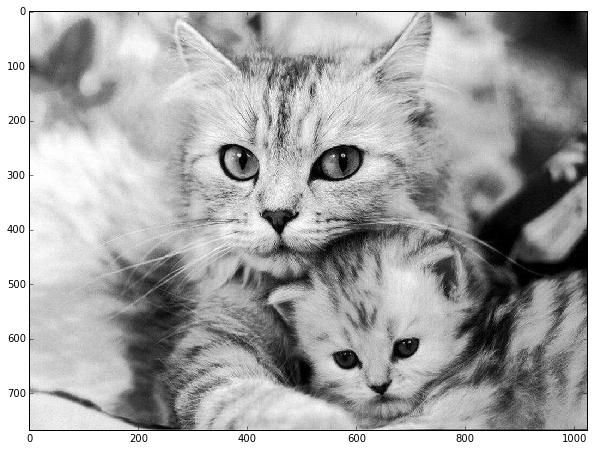

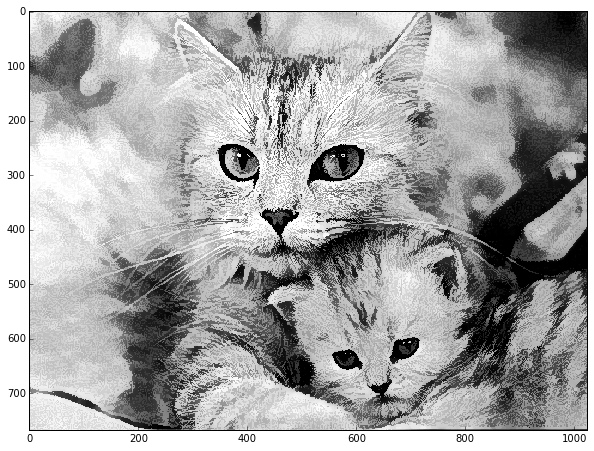

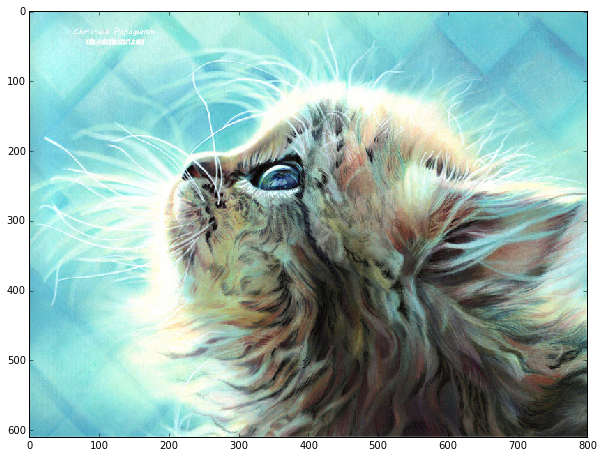

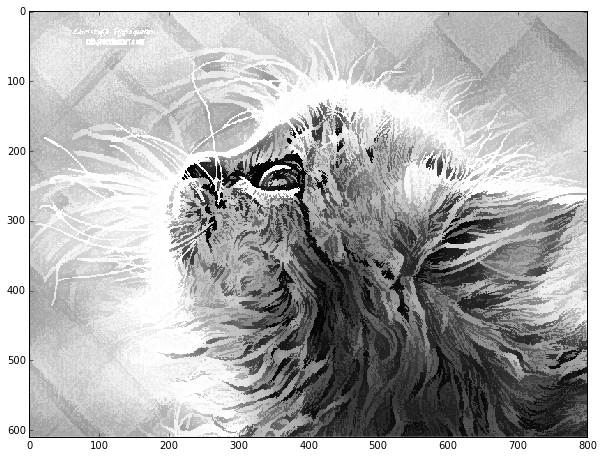

In [47]:
# Enhance Contrast
## Enhances the contrast of the image. It first converts it into greyscale.
## Contrast is the state of being strikingly different from something else,
## typically something in juxtaposition or close association.
def boost_contrast(img):
    if img.ndim == 3:
        img = color.rgb2grey(img) 
    ent = filters.rank.enhance_contrast(img_as_ubyte(img), disk(5))
    return ent

## Apply to the imageset
for i,img in enumerate(imgset):
    new = boost_contrast(img)
    plt.imshow(img)
    plt.show()
    plt.imshow(new)
    plt.show()  

### Add entropy

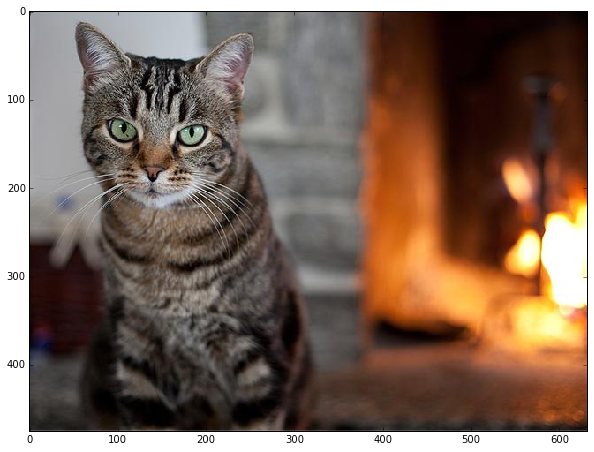

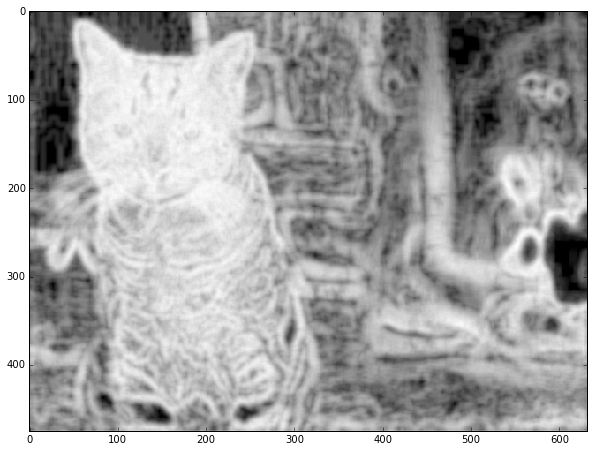

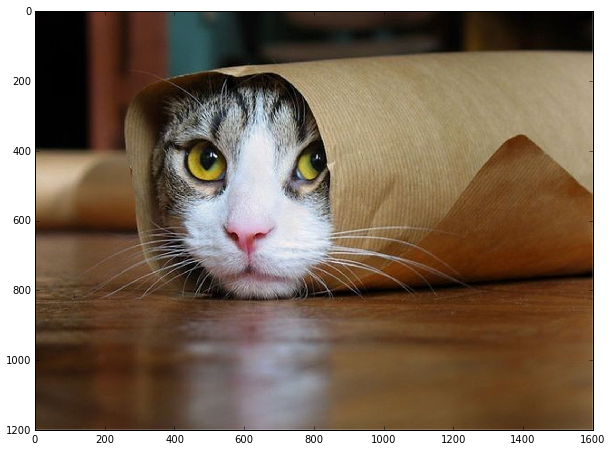

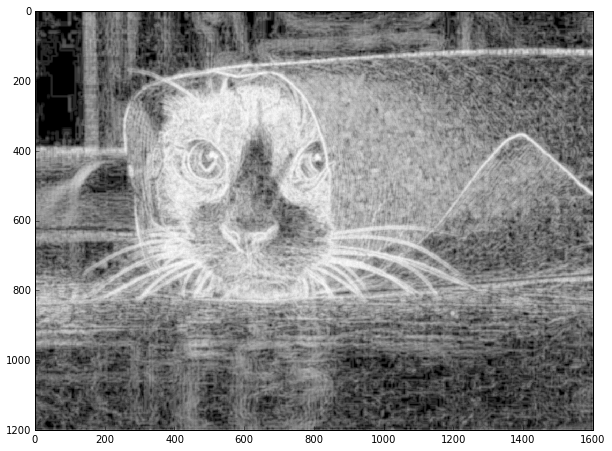

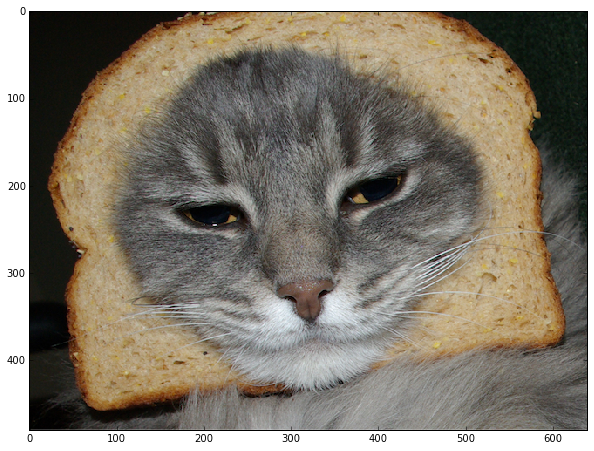

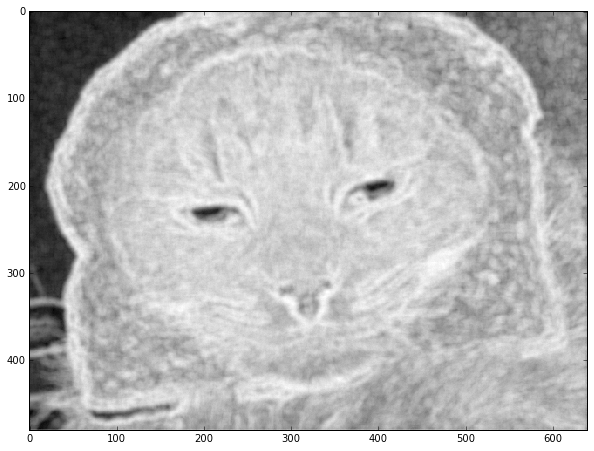

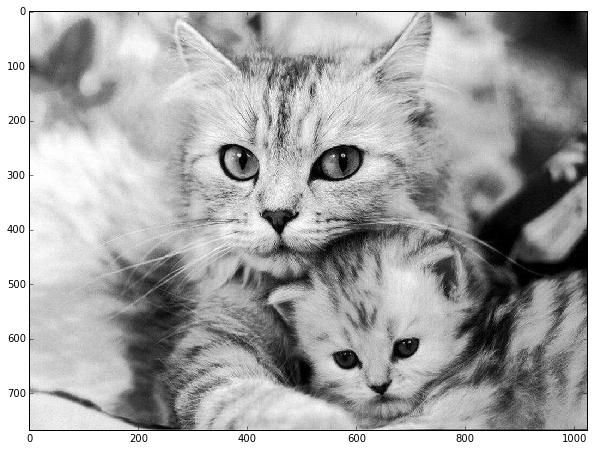

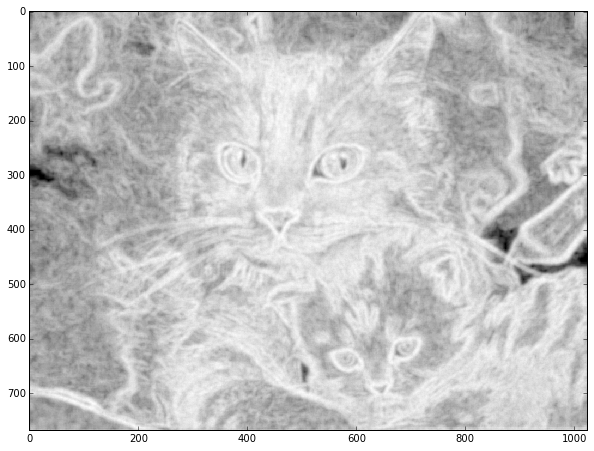

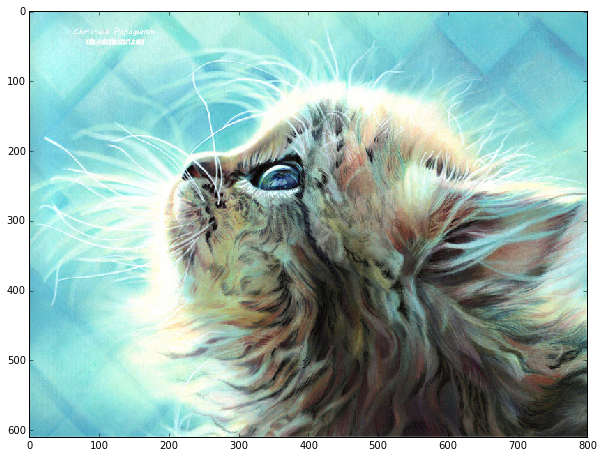

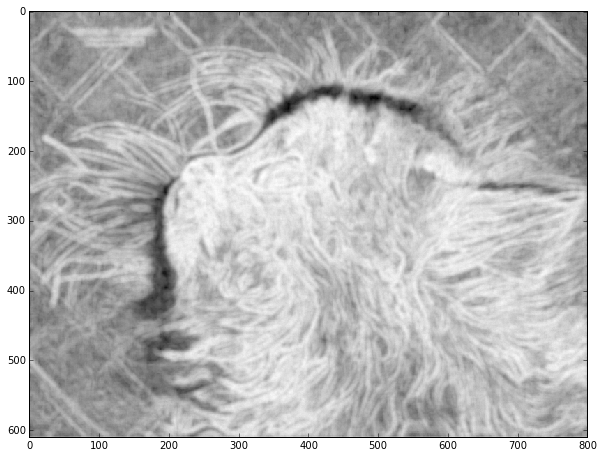

In [48]:
# Add entropy
## Adds entropy to the image. Image entropy
## is a quantity which is used to describe
## the amount of information coded in an image.
def add_entropy(img):
    if img.ndim == 3:
        img = color.rgb2grey(img)
    ent = filters.rank.entropy(img_as_ubyte(img), disk(5))
    return ent

## Apply to the imageset
for i,img in enumerate(imgset):
    new = add_entropy(img)
    plt.imshow(img)
    plt.show()
    plt.imshow(new)
    plt.show()  

### H, S and V color space

In [49]:
# Show HSV as three plots
## Converts the image to HSV, and then plots it as 
## hsv (represents hue), green (represents saturation),
## and gray.
def plot_hsv_components(img):
    if img.ndim == 2: # convert grayscale to rgb
        hsv = color.rgb2hsv(color.gray2rgb(img))
    elif img.ndim == 3:
        hsv = color.rgb2hsv(img)
    else: # Not an image
        print("Must pass a valid RGB or grayscale image")
    plt.subplot(1, 3, 1)
    plt.title('Hue')
    plt.imshow(hsv[:,:,0], cmap='hsv') # Hue
    plt.subplot(1, 3, 2)
    plt.title('Saturation')
    plt.imshow(hsv[:,:,1], cmap='Greens') # Sat
    plt.subplot(1, 3, 3)
    plt.title('Value')
    plt.imshow(hsv[:,:,2], cmap='gray') # Value

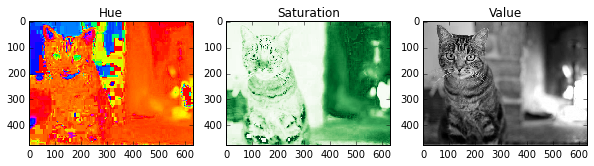

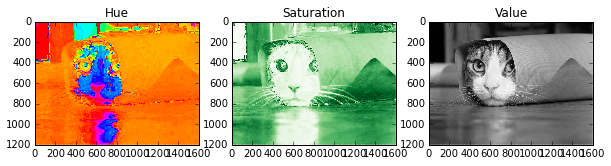

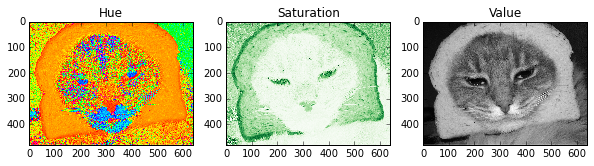

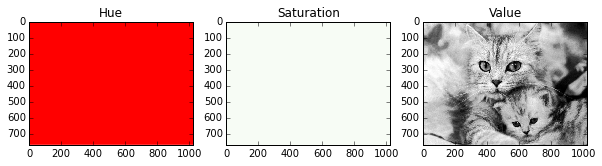

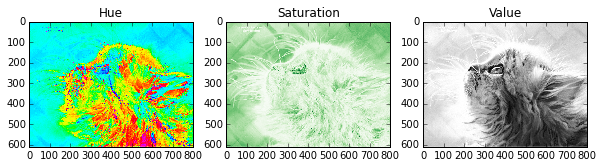

In [50]:
# Apply to image set
## Run the algorithn on all the images
for i,img in enumerate(imgset):
    plt.figure()
    plot_hsv_components(img)

### CIELAB color space. L, a, b channels

In [51]:
# Show Lab as three plots
## Convert the image to rgb and then into the CIELAB color space.
## A Lab color space is a color-opponent space with dimension
## L for lightness and a and b for the color-opponent dimensions,
## based on nonlinearly compressed coordinates.
def plot_Lab_components(img):
    if img.ndim == 2: # convert grayscale to Lab
        lab = color.rgb2lab(color.gray2rgb(img))
    elif img.ndim == 3:
        lab = color.rgb2lab(img)
    else: # Not an image
        print("Must pass a valid RGB or grayscale image")
    plt.subplot(1, 3, 1)
    plt.title('L')
    plt.imshow(lab[:,:,0]) # L
    plt.subplot(1, 3, 2)
    plt.title('a')
    plt.imshow(lab[:,:,1]) # a
    plt.subplot(1, 3, 3)
    plt.title('b')
    plt.imshow(lab[:,:,2]) # b

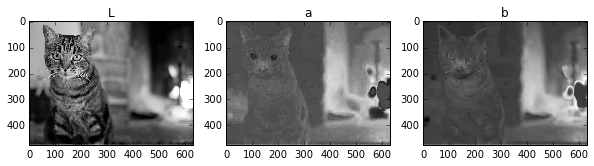

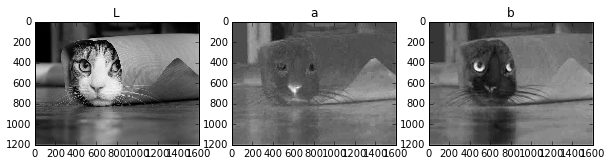

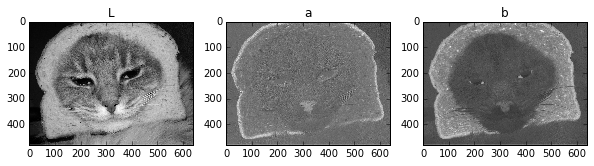

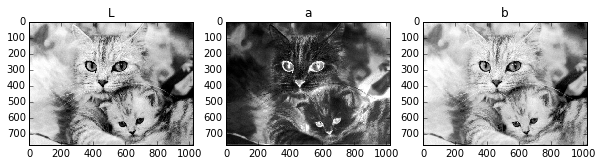

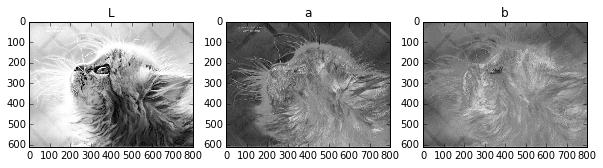

In [52]:
# Apply to image set
## Apply to the imageset
for i,img in enumerate(imgset):
    plt.figure()
    plot_Lab_components(img)

# Image Filters - Convolution of kernels

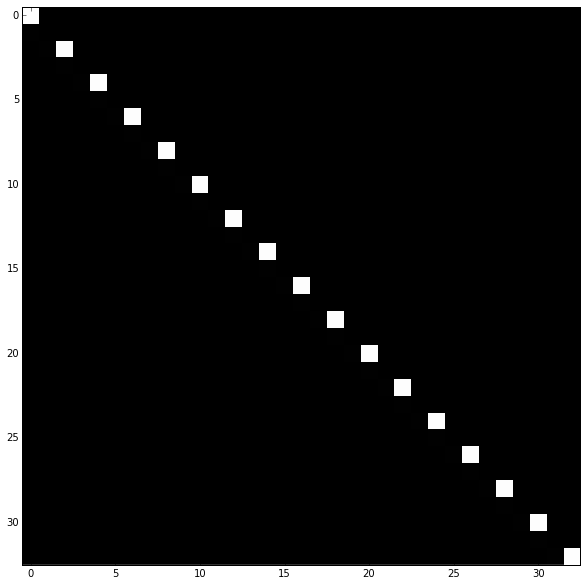

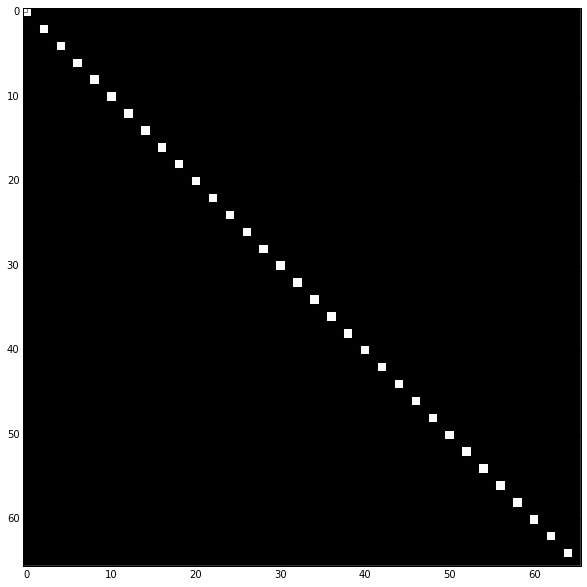

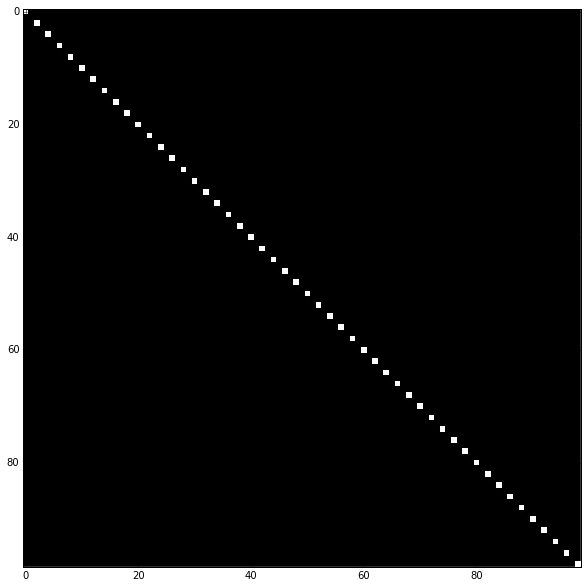

In [53]:
# Create some arbitrary kernel
## Draw boxes diagonally from the top left corner to the bottom
## right corner.
def generate_kernel(size):
    kernel = np.zeros((size,size))
    for x in range(size):
        if x%2==0:
          kernel[x][x] = 1.0    
    kernel = kernel / float(sum(sum(kernel)))
    return kernel

## Apply to the imageset
for x in range (33, 100, 33):
    kernel = generate_kernel(x)
    plt.figure()
    plt.subplot(1, 1, 1)
    plt.imshow(kernel)

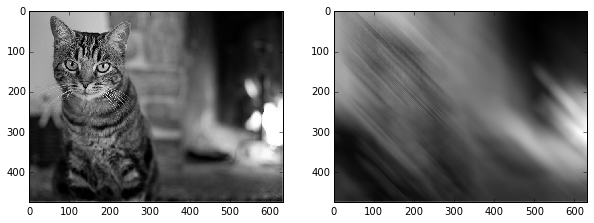

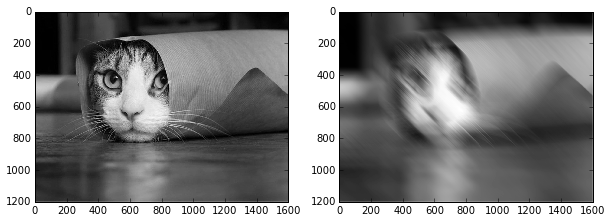

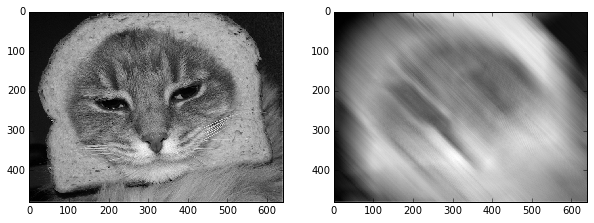

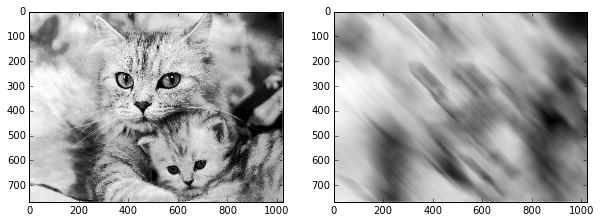

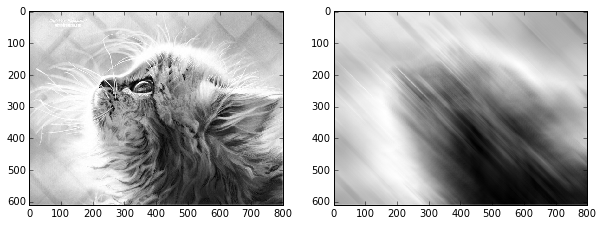

In [54]:
# Apply to image set
## Apply to the imageset. Convolve the images
## and make them blurry.
for i,img in enumerate(imgset):
    imgbw = color.rgb2grey(img)
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 2, 2)
    plt.imshow(convolve(imgbw, kernel))

## Downsampling

In [55]:
# Downsample an image by skipping indicies
## Downsample the image using different
## levels of decimation
def decimate_image(img, skip):
     return img[::skip,::skip]

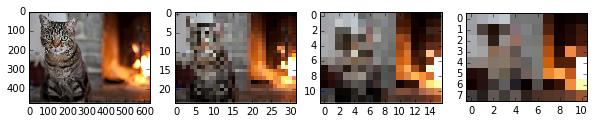

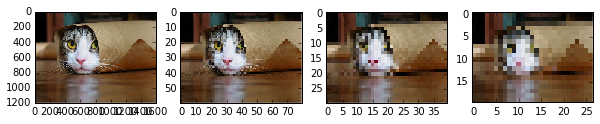

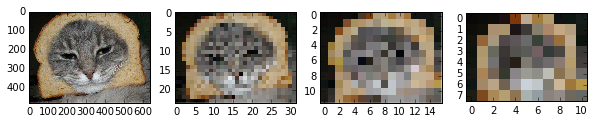

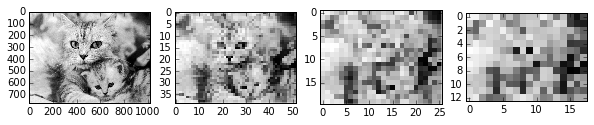

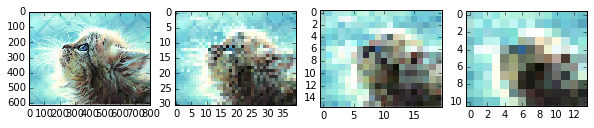

In [56]:
# Apply to image set
## Apply to the imageset
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 4, 1)
    plt.imshow(img)
    plt.subplot(1, 4, 2)
    plt.imshow(decimate_image(img, 20))
    plt.subplot(1, 4, 3)
    plt.imshow(decimate_image(img, 40))
    plt.subplot(1, 4, 4)
    plt.imshow(decimate_image(img, 60))

## Gaussian filters

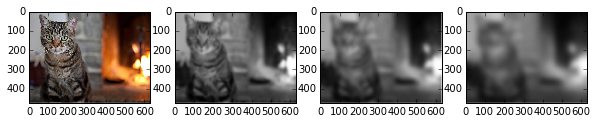

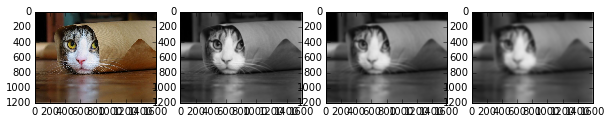

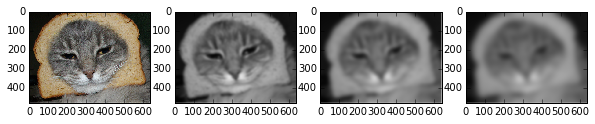

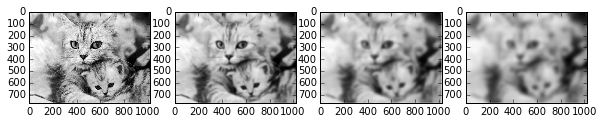

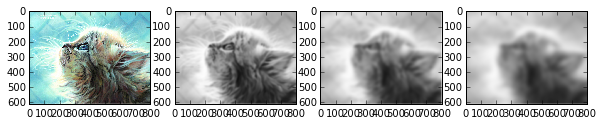

In [57]:
# Apply to image set
## The Gaussian smoothing operator is a 2-D convolution
## operator that is used to `blur' images and remove
## detail and noise. 
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 4, 1)
    plt.imshow(img)
    plt.subplot(1, 4, 2)
    plt.imshow(filters.gaussian_filter(img, 5.0,mode='reflect', multichannel=False))
    plt.subplot(1, 4, 3)
    plt.imshow(filters.gaussian_filter(img, 10.0,mode='reflect', multichannel=False))
    plt.subplot(1, 4, 4)
    plt.imshow(filters.gaussian_filter(img, 15.0,mode='reflect', multichannel=False))

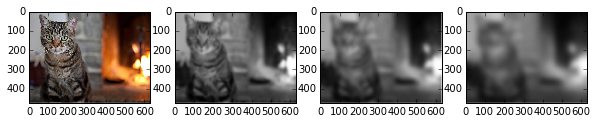

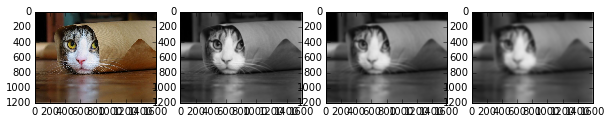

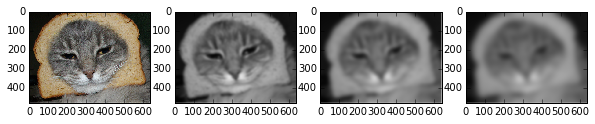

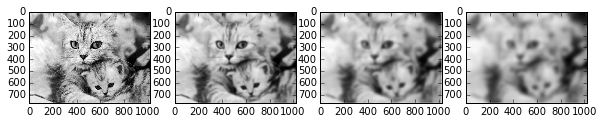

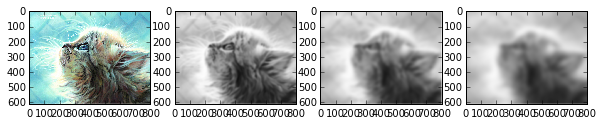

In [58]:
# Apply to image set
## Apply to the imageset

## The Gaussian smoothing operator is a 2-D convolution
## operator that is used to `blur' images and remove
## detail and noise. 
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 4, 1)
    plt.imshow(img)
    plt.subplot(1, 4, 2)
    plt.imshow(filters.gaussian_filter(img, 5.0,mode='reflect', multichannel=False))
    plt.subplot(1, 4, 3)
    plt.imshow(filters.gaussian_filter(img, 10.0,mode='reflect', multichannel=False))
    plt.subplot(1, 4, 4)
    plt.imshow(filters.gaussian_filter(img, 15.0,mode='reflect', multichannel=False))

## Spatial difference filters

In [59]:
# Find horizontal edges using a simple shifting method
## Display the horizontal edges of the picture as white lines
def find_horizontal_edges(img):
    imgbw = img_as_float(color.rgb2grey(img))
    return np.abs(imgbw[:, 1:] - imgbw[:, :-1])

# Find vertical edges using a simple shifting method
## Display the vertical edges of the picture as white lines
def find_vertical_edges(img):
    imgbw = img_as_float(color.rgb2grey(img))
    return np.abs(imgbw[1:, :] - imgbw[:-1, :])

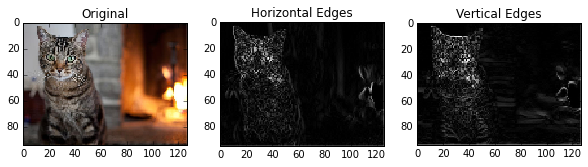

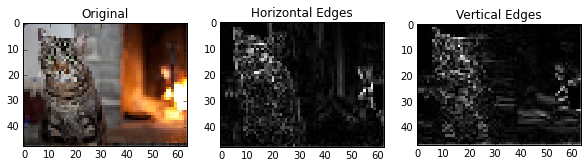

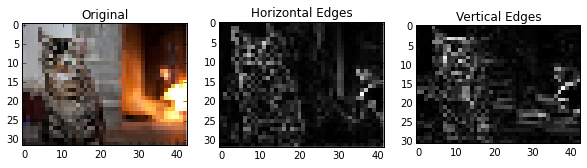

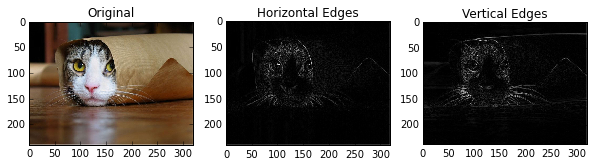

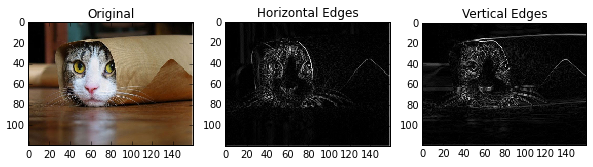

...

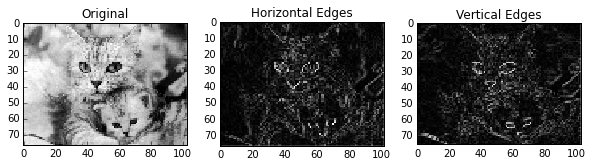

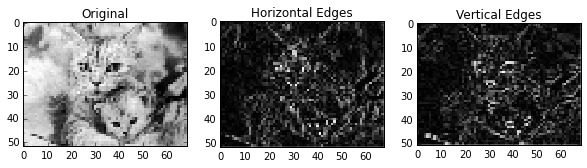

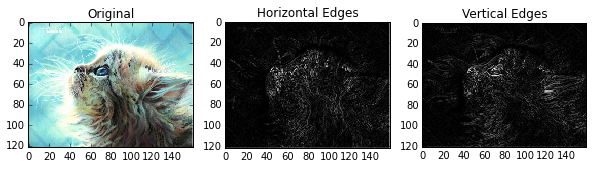

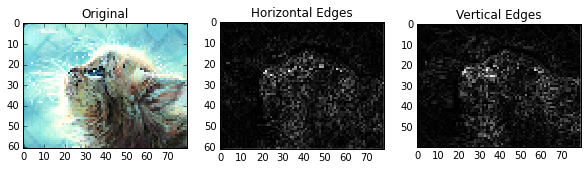

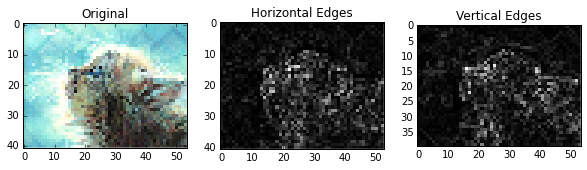

In [60]:
# Apply to image set
## Apply to the imageset
for i,img in enumerate(imgset):
    for x in range (5, 16, 5):
        decimg = decimate_image(img, x) # downsample to make it easier to see graphs
        plt.figure()
        plt.subplot(1, 3, 1)
        plt.title('Original')
        plt.imshow(decimg)
        plt.subplot(1, 3, 2)
        plt.title('Horizontal Edges')
        plt.imshow(find_horizontal_edges(decimg))
        plt.subplot(1, 3, 3)
        plt.title('Vertical Edges')
        plt.imshow(find_vertical_edges(decimg))

## Difference filter pair-wise differences

In [61]:
# Find the absolute difference between two images. Crops to the shared region between images.
## Find the absolute difference between the two images. Combine the the two images, and
## crop out the shared region of that image.
def find_pairwise_difference(img_a, img_b):
    subset = np.minimum(img_a.shape, img_b.shape)
    img_a_subset = img_a[:subset[0], :subset[1]]
    img_b_subset = img_b[:subset[0], :subset[1]]
    return img_a_subset, img_b_subset, np.abs(img_a_subset - img_b_subset)

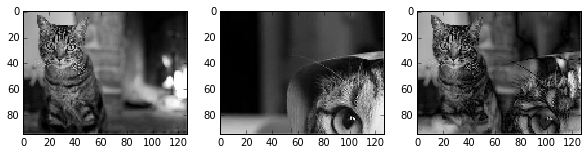

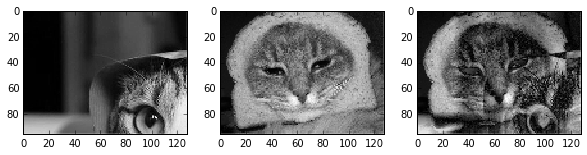

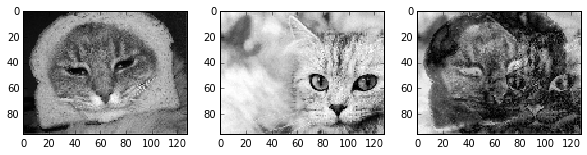

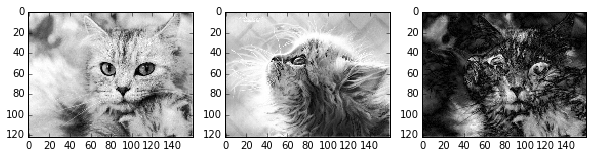

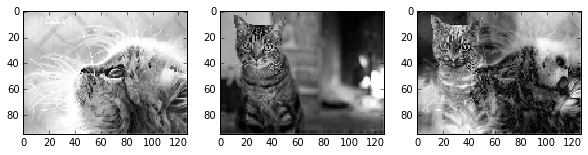

In [62]:
# Apply to image set
## Apply to the imageset
for i in range(len(imgset)):
    decimg_a = img_as_float(color.rgb2grey(decimate_image(imgset[i], 5))) # downsample to make it easier to see graphs
    decimg_b = img_as_float(color.rgb2grey(decimate_image(imgset[(i+1) % len(imgset)], 5)))
    a, b, d = find_pairwise_difference(decimg_a, decimg_b)
    plt.figure()
    plt.subplot(1, 3, 1)
    plt.imshow(a)
    plt.subplot(1, 3, 2)
    plt.imshow(b)
    plt.subplot(1, 3, 3)
    plt.imshow(d)

In [63]:
# Find the squared difference between two images. Crops to the shared region between images.
## Find the squared difference between the two images. Combine the the two images, and
## crop out the shared region of that image.
def find_pairwise_difference_squared(img_a, img_b):
    subset = np.minimum(img_a.shape, img_b.shape)
    img_a_subset = img_a[:subset[0], :subset[1]]
    img_b_subset = img_b[:subset[0], :subset[1]]
    return img_a_subset, img_b_subset, np.square(img_a_subset - img_b_subset)

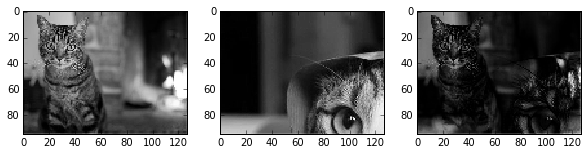

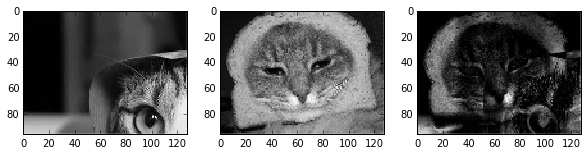

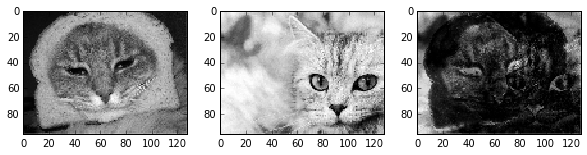

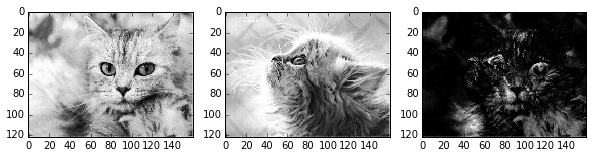

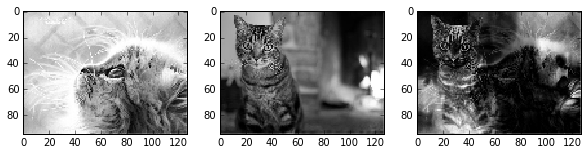

In [64]:
# Apply to image set
## Apply to the imageset
for i in range(len(imgset)):
    decimg_a = img_as_float(color.rgb2grey(decimate_image(imgset[i], 5))) # downsample to make it easier to see graphs
    decimg_b = img_as_float(color.rgb2grey(decimate_image(imgset[(i+1) % len(imgset)], 5)))
    a, b, d = find_pairwise_difference_squared(decimg_a, decimg_b)
    plt.figure()
    plt.subplot(1, 3, 1)
    plt.imshow(a)
    plt.subplot(1, 3, 2)
    plt.imshow(b)
    plt.subplot(1, 3, 3)
    plt.imshow(d)

## Feature Detection

### Sobel filter

In [65]:
# Apply a Sobel filter to the image.
## Creates an image emphasising edges.
def apply_sobel(img):
    sobel_kernel = np.array([[-1, 0, +1],[-2, 0, +2],[-1, 0, +1]])
    Gx = convolve(img, sobel_kernel)
    Gy = convolve(img, -sobel_kernel.transpose())
    return np.sqrt(np.square(Gx) + np.square(Gy))

# This should do the same thing as skimage.filters.sobel(img)

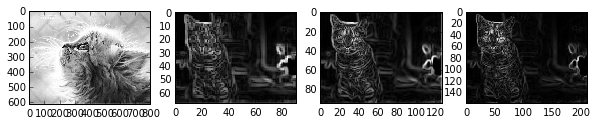

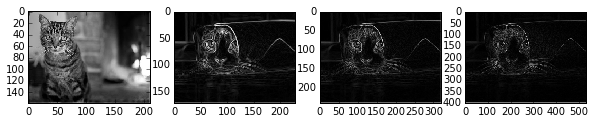

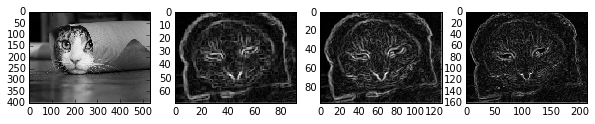

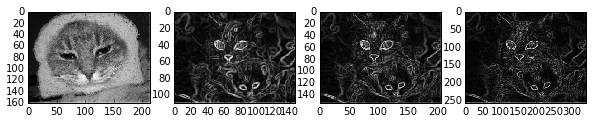

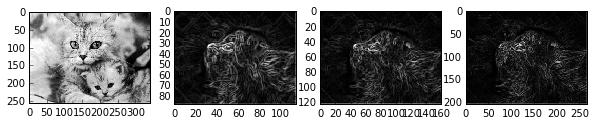

In [66]:
# Apply to image set
## Apply to the imageset
for i,img in enumerate(imgset):
    plt.figure()
    plt.subplot(1, 4, 1)
    plt.imshow(imgbw)
    imgbw = img_as_float(color.rgb2grey(decimate_image(img, 7))) # downsample to make it easier to see graphs
    plt.subplot(1, 4, 2)
    plt.imshow(apply_sobel(imgbw))
    imgbw = img_as_float(color.rgb2grey(decimate_image(img, 5)))
    plt.subplot(1, 4, 3)
    plt.imshow(apply_sobel(imgbw))
    imgbw = img_as_float(color.rgb2grey(decimate_image(img, 3)))
    plt.subplot(1, 4, 4)
    plt.imshow(apply_sobel(imgbw))

### Canny edge detector 

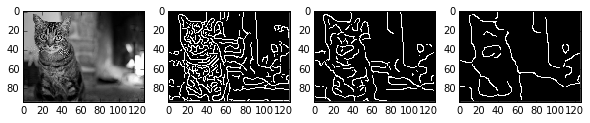

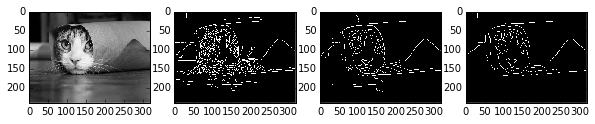

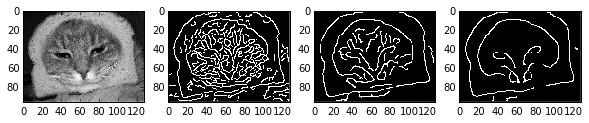

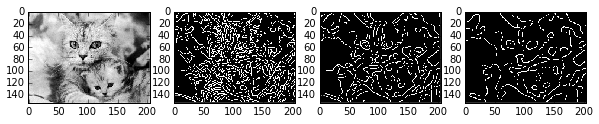

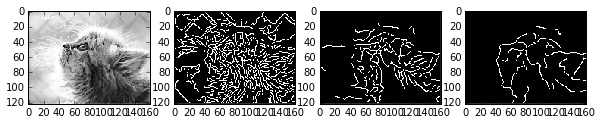

In [67]:
# Apply to image set
## Use the canny edge detector to detect a wide range of edges.
## Detects more edges based on the parameter.
for i,img in enumerate(imgset):
    imgbw = img_as_float(color.rgb2grey(decimate_image(img, 5))) # downsample to make it easier to see graphs
    plt.figure()
    plt.subplot(1, 4, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 4, 2)
    plt.imshow(feature.canny(imgbw, 1.0))
    plt.subplot(1, 4, 3)
    plt.imshow(feature.canny(imgbw, 2.0))
    plt.subplot(1, 4, 4)
    plt.imshow(feature.canny(imgbw, 3.0))

### Hough transforms

In [68]:
# Plot the circular Hough transforms of an image at the given radii.
## Run the Hough transform on the images. It identifies lines in the image,
## and it got extended to identify other shapes such as circles and
## ellipses as well.
def plot_circle_hough(img, radii, sigma):
    edges = feature.canny(img, sigma)
    hough = hough_circle(edges, radii)
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 2, 2)
    plt.imshow(edges)
    plt.figure()
    for j in range(len(hough)):
        if len(hough)==0: continue
        plt.subplot(1, len(hough), j)
        plt.imshow(hough[j,:,:])    

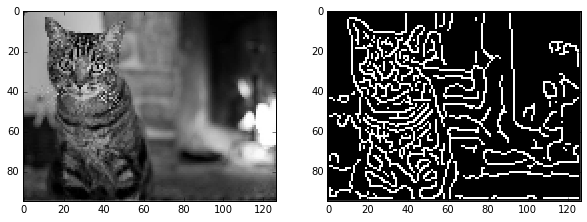

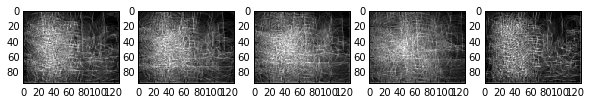

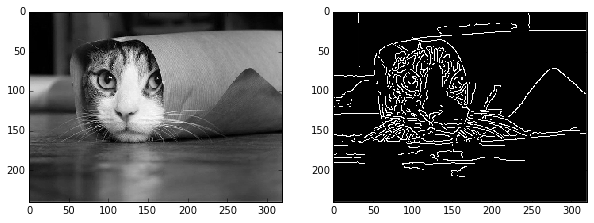

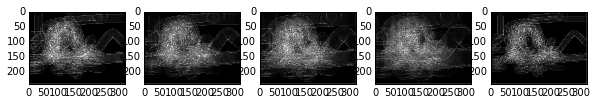

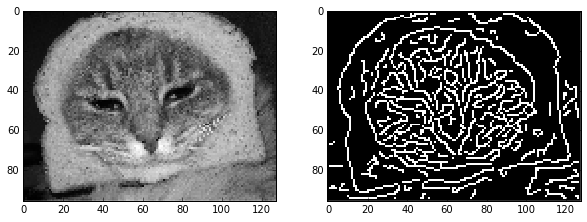

...

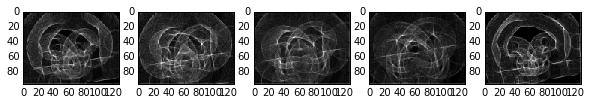

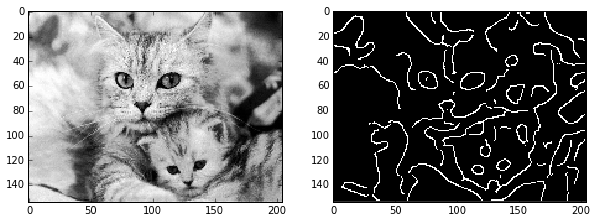

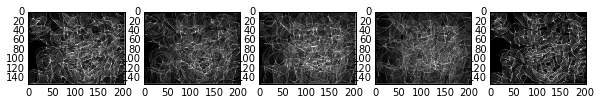

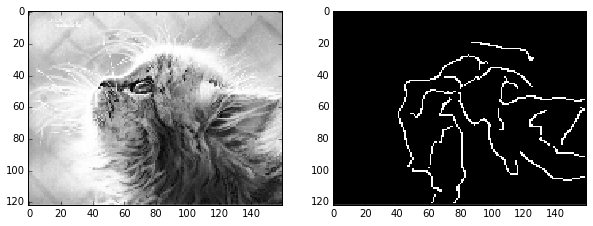

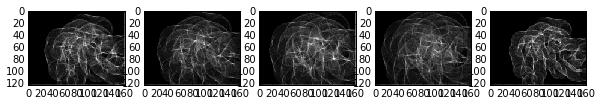

In [69]:
# Apply to image set
## Apply to the imageset. Downsample it first and convert
## it to greyscale. After that, run the algorithm.
for sigma in range (1, 4):
    radii = np.arange(10, 35, 5)
    for i,img in enumerate(imgset):
        imgbw = img_as_float(color.rgb2grey(decimate_image(img, 5))) # downsample to make it easier to see graphs
        plot_circle_hough(imgbw, radii, sigma)

## Morphological Operations

### Morphological operations - de-noising

In [70]:
# Applies a morphological operator to remove noise
## Removes noise in the image by applying the
## morphological operator.
def morpho_denoise(img, shape, size):
    if shape == 'square':
        kernel = morphology.square(width=size)
    elif shape == 'diamond':
        kernel = morphology.diamond(radius=size)
    else:
        print("Shape must be 'square' or 'diamond'.")
        return None
    return morphology.opening(img, kernel)

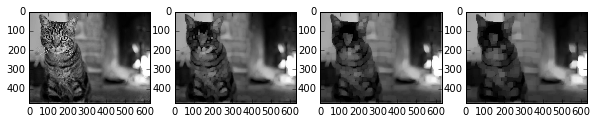

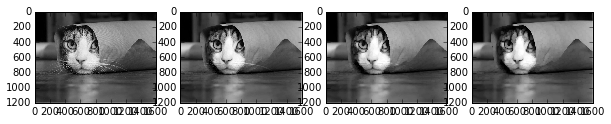

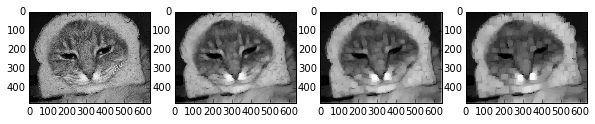

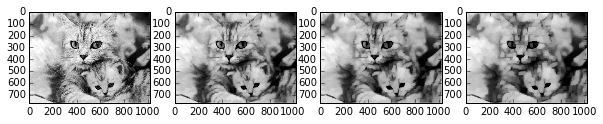

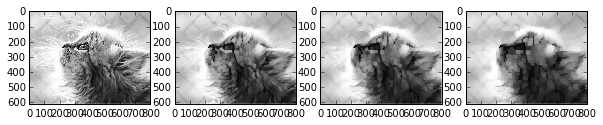

In [71]:
# Apply to image set
## Apply to the imageset. Run the algorithm on a
## few different parameters that determine
## how much to denoise the images.
for i,img in enumerate(imgset):
    imgbw = img_as_float(color.rgb2grey(img))
    plt.figure()
    plt.subplot(1, 4, 1)
    plt.imshow(imgbw)
    plt.subplot(1, 4, 2)
    plt.imshow(morpho_denoise(imgbw, 'square', 10))
    plt.subplot(1, 4, 3)
    plt.imshow(morpho_denoise(imgbw, 'square', 15))
    plt.subplot(1, 4, 4)
    plt.imshow(morpho_denoise(imgbw, 'square', 20))

## Segmentation

### SLIC (Simple Linear Iterative Clustering)

In [72]:
# Calculate the mean color of slic regions, from the SciKit tutorial
## Find the mean color of different regions.
def mean_color(image, labels):
    out = np.zeros_like(image)
    for label in np.unique(labels):
        indices = np.nonzero(labels == label)
        out[indices] = np.mean(image[indices], axis=0)
    return out

## Split the image up into different, similar regions. It is also
## known as finding superpixels.
def plot_slic_segmentation(img):
    labels = seg.slic(img, n_segments=24, compactness=70, sigma=2.0, enforce_connectivity=True)
    return mean_color(img, labels)

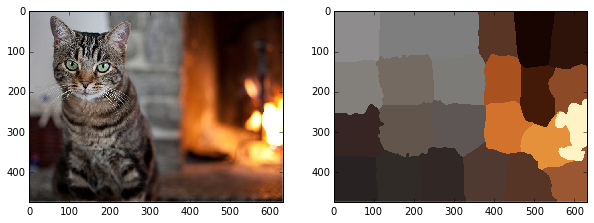

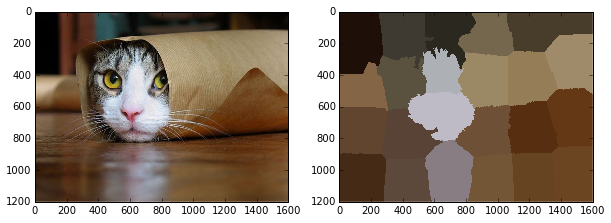

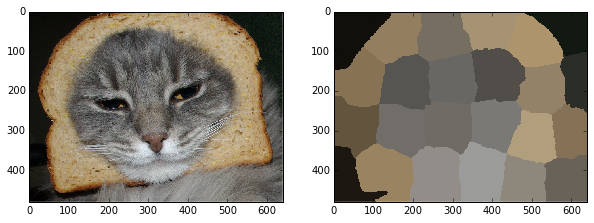

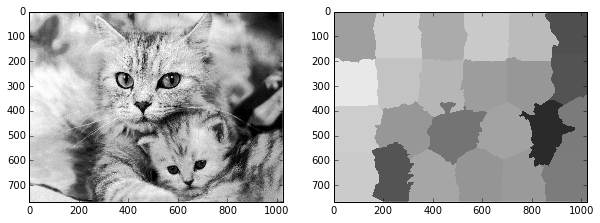

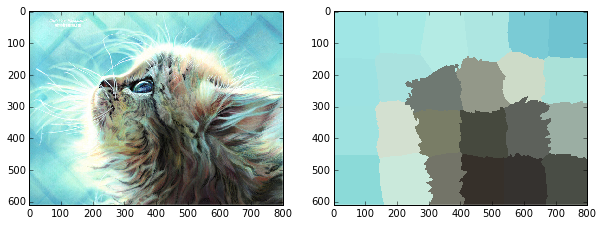

In [73]:
# Apply to the images
## Apply to the imageset. 
for i,img in enumerate(imgset):
    rgbimg = img_as_float(color.gray2rgb(img))
    plt.figure()
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.subplot(1, 2, 2)
    plt.imshow(plot_slic_segmentation(rgbimg))

### Watershed algorithm

In [ ]:
# Show a watershed plot of an image
## Apply a watershed to the image. The watershed is a
## classical algorithm used for segmentation, that is,
## for separating different objects in an image.
def plot_watershed(img, sigma):
    edges = feature.canny(img, sigma)
    distance_from_edge = nd.distance_transform_edt(-edges)
    peaks = peak_local_max(distance_from_edge)
    peaks_image = np.zeros(img.shape, np.bool)
    peaks_image[tuple(np.transpose(peaks))] = True
    seeds, num_seeds = nd.label(peaks_image)
    plt.plot(peaks[:, 1], peaks[:, 0], 'ro')
    ws = watershed(edges, seeds)
    plt.imshow(color.label2rgb(ws, img))

/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:7: DeprecationWarning: numpy boolean negative (the unary `-` operator) is deprecated, use the bitwise_xor (the `^` operator) or the logical_xor function instead.


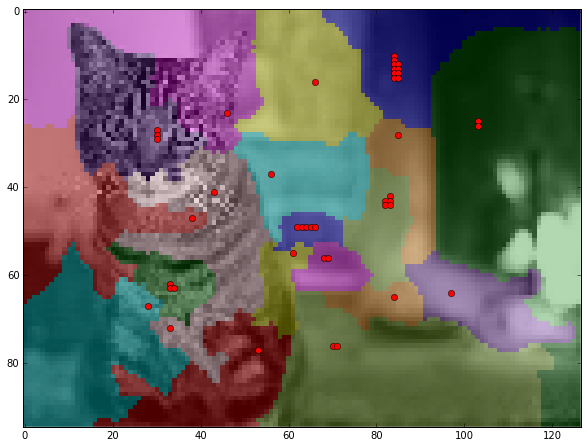

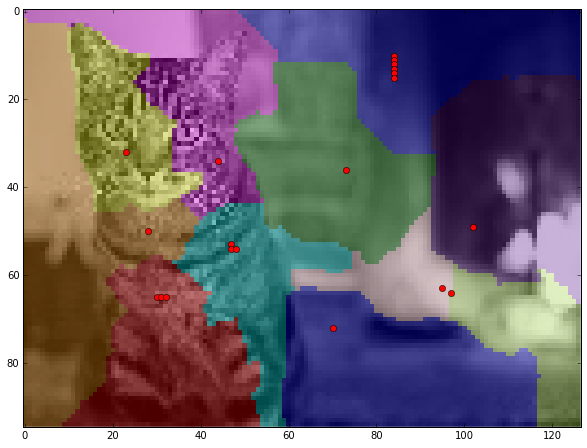

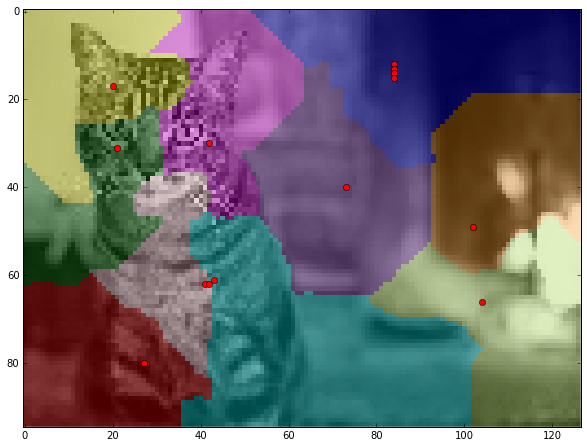

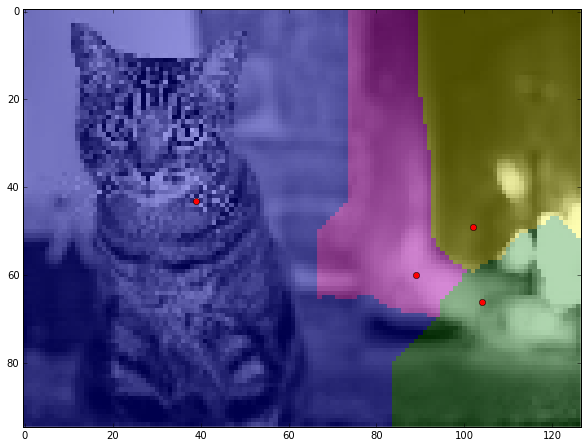

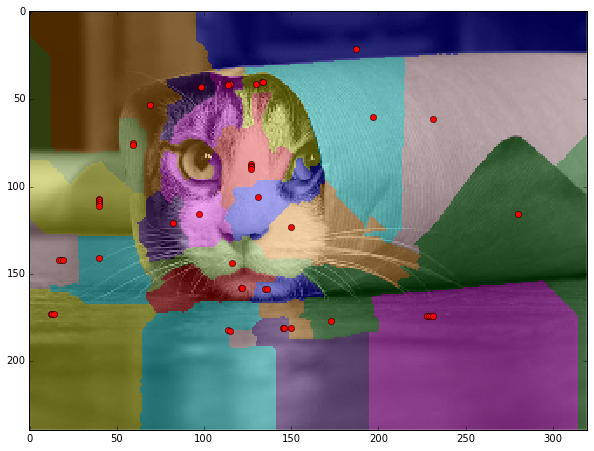

...

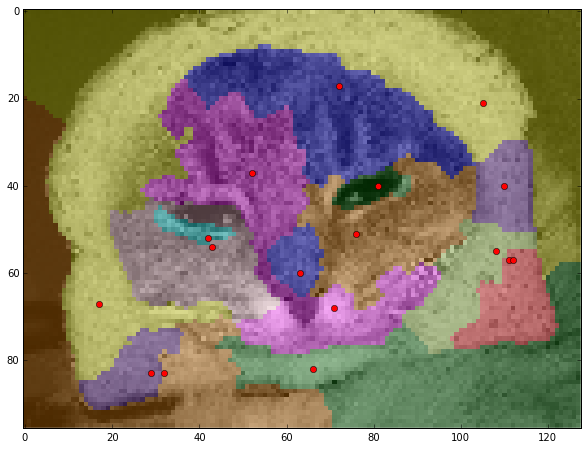

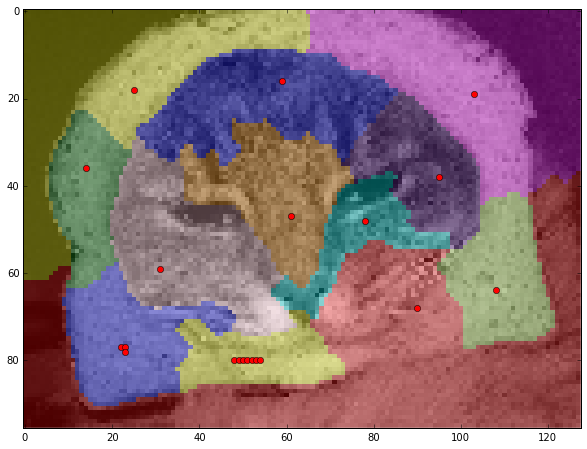

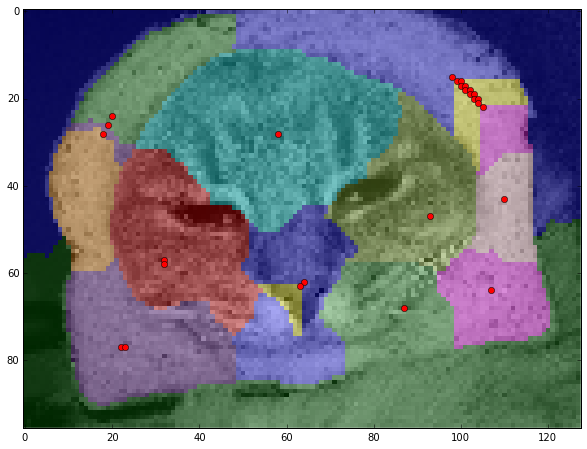

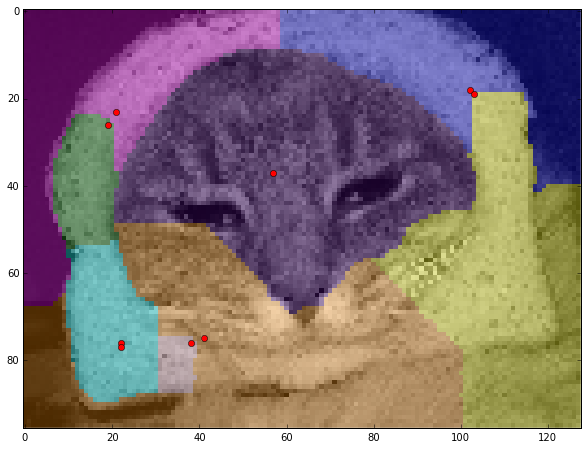

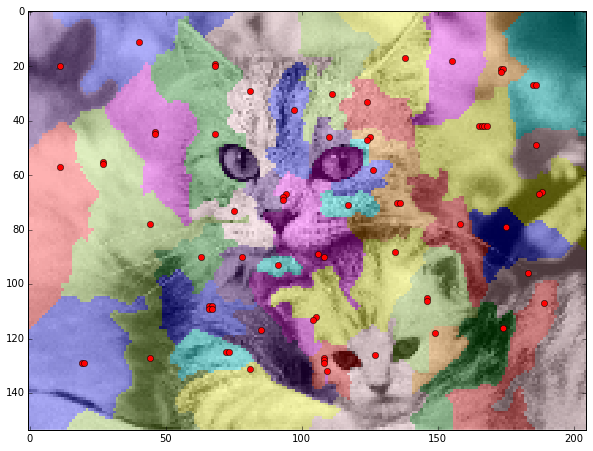

In [ ]:
# Apply to the images
## Apply to the imageset.
for i,img in enumerate(imgset):
    for x in range (1, 5):
        imgbw = (color.rgb2grey(decimate_image(img, 5)))
        plt.figure()
        plot_watershed(imgbw, x)